**Mounting Google Driver for Faster Processing & Storing Models**

---



In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
bs = 102 # batch size

**Importing fastai & other required packages**

---



In [3]:
!pip install -Uqq fastai fastbook nbdev

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.1/66.1 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 507.1/507.1 kB 14.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.7/58.7 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 18.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 33.8 MB/s eta 0:00:00


In [4]:
from fastai import *
from fastbook import *
from fastai.vision.all import *

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

**Locating Data Path**

---



In [6]:
%cd /content/drive/MyDrive/jpg

/content/drive/MyDrive/jpg


In [7]:
data_path ='/content/drive/MyDrive/jpg'
image_count = get_image_files(data_path)
image_count

(#8189) [Path('/content/drive/MyDrive/jpg/wallflower/image_00958.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00951.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00954.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00947.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00955.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00956.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00957.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00952.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00949.jpg'),Path('/content/drive/MyDrive/jpg/wallflower/image_00953.jpg')...]

**Resizing & Randomsplitting Images for Training Purposes**

---



In [8]:
dblock = DataBlock(
    blocks = (ImageBlock, CategoryBlock),
    get_items = get_image_files,
    splitter=RandomSplitter(valid_pct = 0.1, seed = 42),
    get_y = parent_label,
    item_tfms=Resize(128)
)

In [9]:
dls = dblock.dataloaders(data_path, bs=bs)

**Extracting Exact Secuence of all Items created by Code**

---



In [10]:
dls.train.vocab

['alpine sea holly', 'anthurium', 'artichoke', 'azalea', 'ball moss', 'balloon flower', 'barbeton daisy', 'bearded iris', 'bee balm', 'bird of paradise', 'bishop of llandaff', 'black-eyed susan', 'blackberry lily', 'blanket flower', 'bolero deep blue', 'bougainvillea', 'bromelia', 'buttercup', 'californian poppy', 'camellia', 'canna lily', 'canterbury bells', 'cape flower', 'carnation', 'cautleya spicata', 'clematis', "colt's foot", 'columbine', 'common dandelion', 'corn poppy', 'cyclamen', 'daffodil', 'desert-rose', 'english marigold', 'fire lily', 'foxglove', 'frangipani', 'fritillary', 'garden phlox', 'gaura', 'gazania', 'geranium', 'giant white arum lily', 'globe thistle', 'globe-flower', 'grape hyacinth', 'great masterwort', 'hard-leaved pocket orchid', 'hibiscus', 'hippeastrum', 'japanese anemone', 'king protea', 'lenten rose', 'lotus', 'love in the mist', 'magnolia', 'mallow', 'marigold', 'mexican aster', 'mexican petunia', 'monkshood', 'moon orchid', 'morning glory', 'orange da

**Checking if Dataset is okay or not**

---



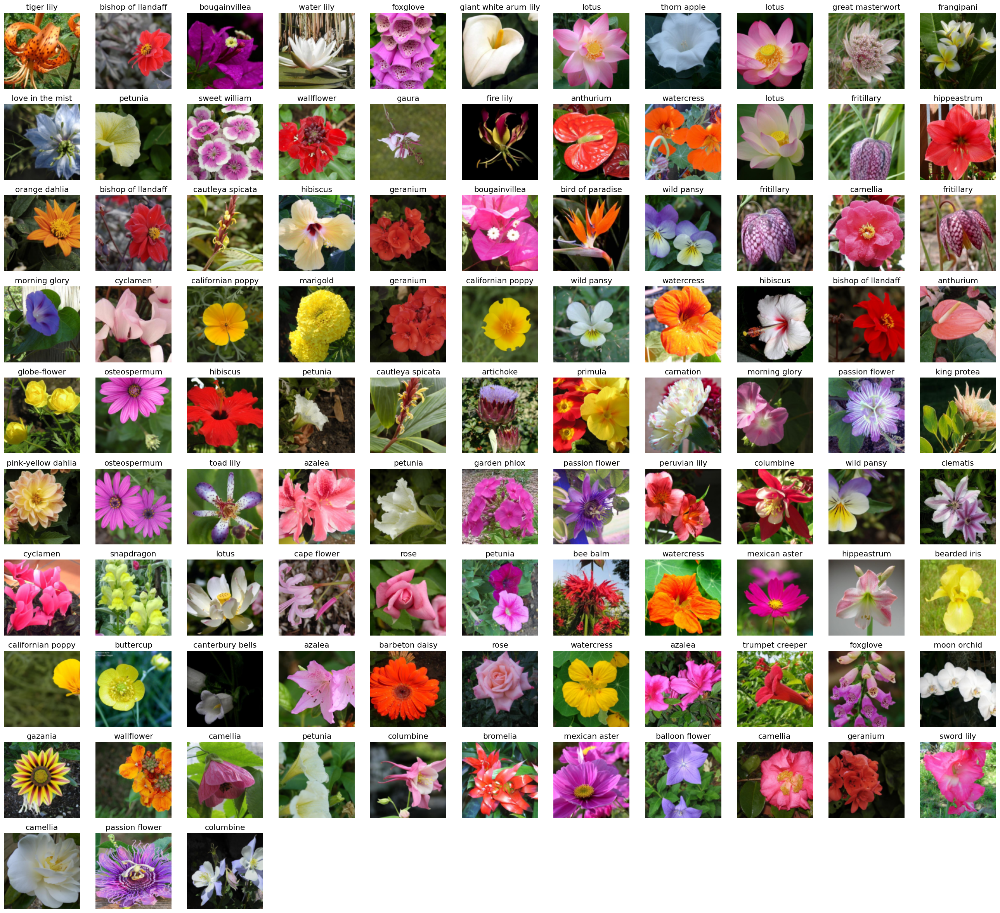

In [11]:
dls.train.show_batch(max_n = 102, nrows = 10)

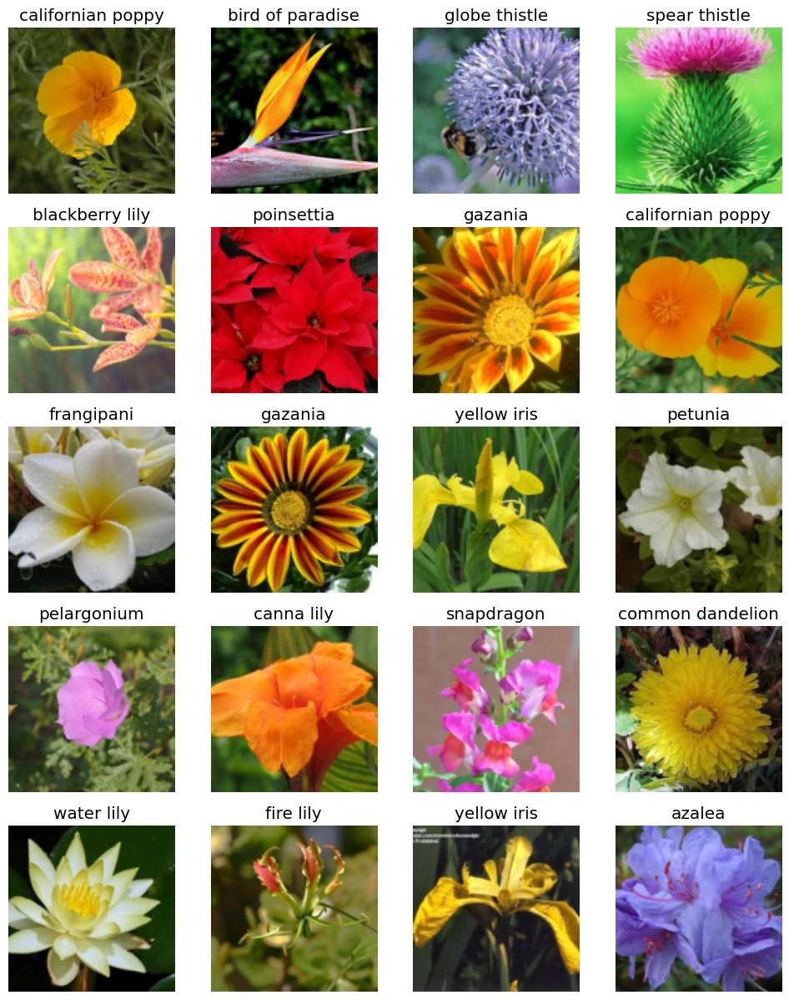

In [12]:
dls.valid.show_batch(max_n=20, nrows=5)

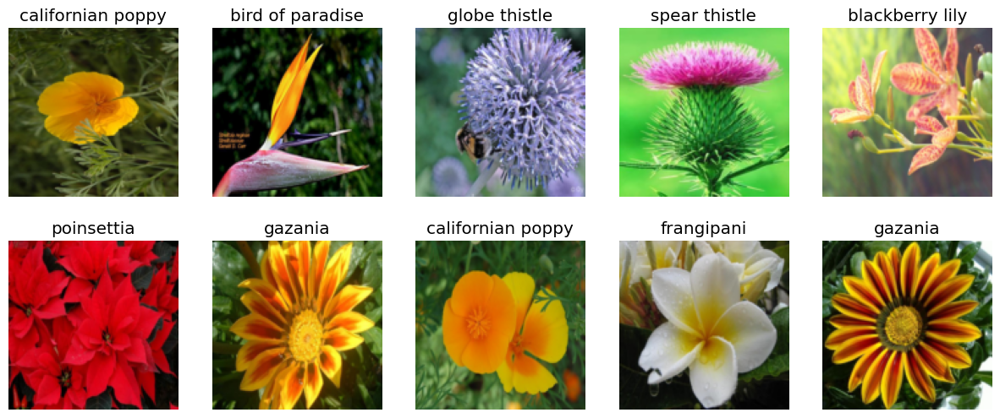

In [13]:
dblock = dblock.new(item_tfms=Resize(128, ResizeMethod.Squish)) # Squishing the whole image into (128 x 128) size
dls = dblock.dataloaders(data_path)
dls.valid.show_batch(max_n=10, nrows=2)

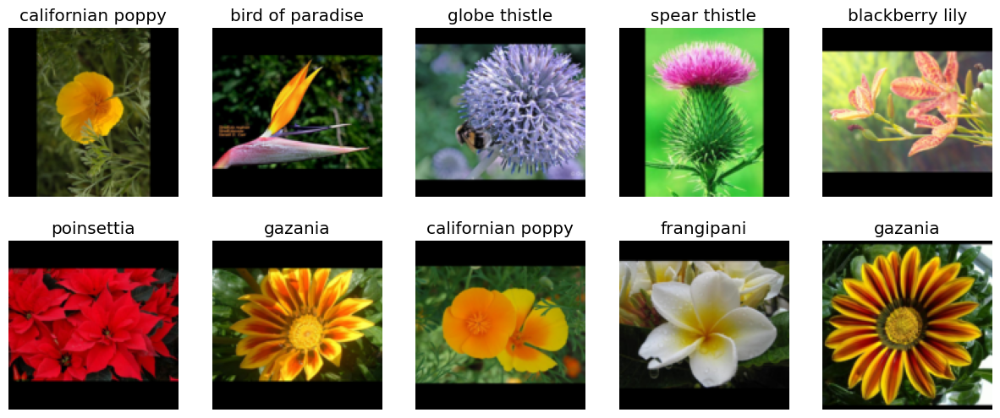

In [14]:
dblock = dblock.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros')) # Padding the extra spaced the whole image into (128 x 128) size without squishing
dls = dblock.dataloaders(data_path)
dls.valid.show_batch(max_n=10, nrows=2)

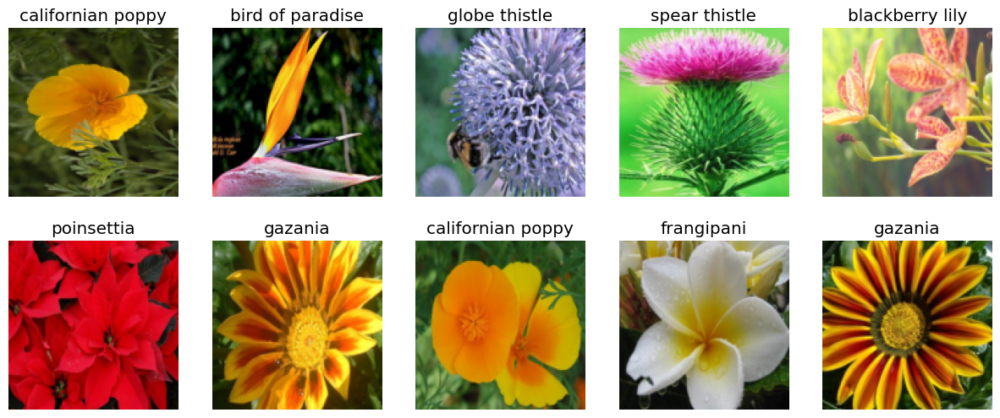

In [15]:
dblock = dblock.new(item_tfms=RandomResizedCrop(128, min_scale=0.3)) # Randomly cropping, cutting, resizing, coloring parts of image into (128 x 128) size
dls = dblock.dataloaders(data_path)
dls.valid.show_batch(max_n=10, nrows=2)

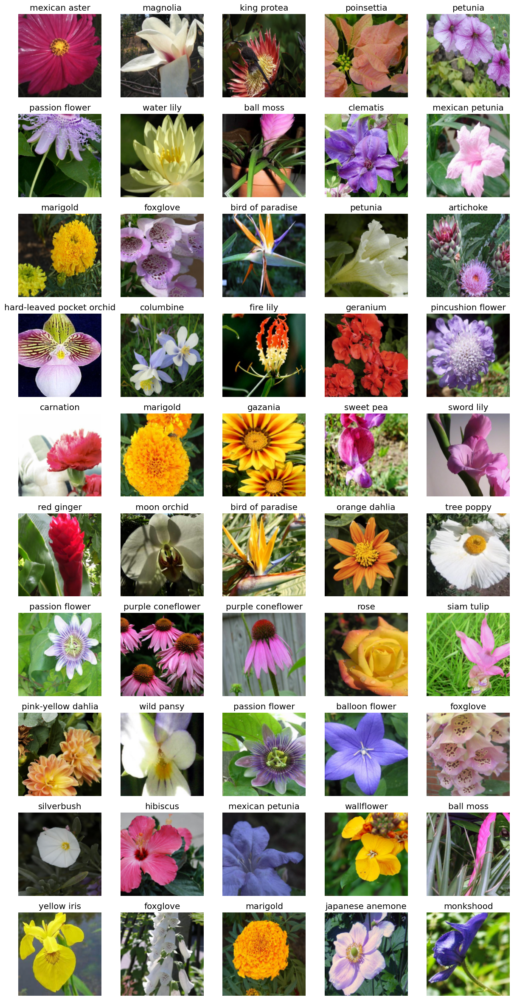

In [16]:
# RandomResizedCrop crops images randomly and create copies so that we don't miss out anything
# aug_transforms is used for image data augmentation
dblock = dblock.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms())
dls = dblock.dataloaders(data_path)
dls.train.show_batch(max_n=50, nrows=10)

**Initial Pre-trained Model Saving**

---



In [17]:
torch.save(dls, "flowers_dataset_v_0.pkl")

In [24]:
version = 1

In [19]:

dblock = DataBlock(
    blocks = (ImageBlock, CategoryBlock),
    get_items = get_image_files,
    splitter=RandomSplitter(valid_pct = 0.1, seed = 42),
    get_y = parent_label,
    item_tfms=Resize(128)
)

**Loading Initial Model & importing resnet50 pretrained model**

---



In [21]:

dblock = dblock.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms())
dls = dblock.dataloaders(data_path, bs=bs)
torch.load(f"flowers_dataset_v_0.pkl")


In [22]:
model = vision_learner(dls, resnet50, metrics=[error_rate, accuracy])

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 155MB/s]


**Model Training untill high sccuracy**

---



In [23]:
model.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.730026,0.625325,0.165037,0.834963,31:54


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.597422,0.257602,0.066015,0.933985,01:35
1,0.350184,0.170302,0.046455,0.953545,01:38
2,0.187590,0.128145,0.033007,0.966993,01:38
3,0.105131,0.107806,0.030562,0.969438,01:35
4,0.075593,0.104437,0.029340,0.970660,01:35


**Initial Saving of Tranined Model**

---



In [25]:
model.save(f"flowers_dataset_trained_v_{version}")

Path('models/flowers_dataset_trained_v_1.pth')

**Using confusion Matrix to get overall insight about dataset**

---



In [26]:
interp = ClassificationInterpretation.from_learner(model)
cm = interp.confusion_matrix()

plt.figure(figsize=(100, 100))
sns.heatmap(cm, annot=True, cmap="Blues")
plt.title("Confusion matrix")
plt.show()

**Less Efficient Prediction(because of same shape & color, for more accuracy we need more data)**

---



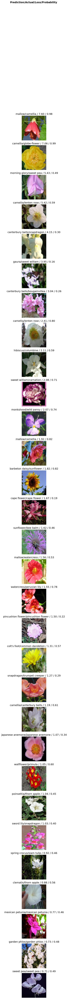

In [27]:
interp.plot_top_losses(30, nrows=30)

**Final Model Saving**

---



In [28]:
from fastai.vision.widgets import *

In [ ]:
cleaner = ImageClassifierCleaner(model)
cleaner

In [ ]:
model.export(f"final_flowers_dataset_v_{version}.pkl")

**Model Testing**

---



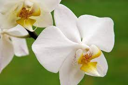

In [32]:
img = Image.open('/content/download.jpg')
img.to_thumb(128,128)

In [33]:
model.predict('/content/download.jpg')

('moon orchid',
 tensor(61),
 tensor([3.1648e-07, 2.1159e-07, 3.1733e-07, 9.1530e-08, 7.7815e-07, 2.1803e-06, 1.3871e-07, 2.0682e-06, 7.4663e-07, 1.2655e-06, 5.9818e-07, 1.8202e-06, 1.1429e-06, 1.2944e-07, 1.0335e-06, 3.3879e-05,
         1.3562e-06, 2.0515e-05, 1.8423e-05, 7.4425e-06, 2.0520e-06, 9.8538e-06, 1.3326e-06, 2.8439e-07, 6.1099e-06, 6.1472e-08, 5.6008e-07, 1.6835e-04, 8.2399e-08, 8.3813e-06, 5.0055e-06, 1.5645e-05,
         2.0391e-07, 5.6538e-08, 1.3320e-07, 3.7407e-06, 5.1623e-06, 3.5370e-06, 2.4154e-06, 1.0845e-06, 1.4993e-07, 5.3498e-07, 2.7975e-04, 3.8585e-06, 1.2169e-06, 1.1272e-06, 4.0723e-06, 5.0586e-05,
         8.2379e-09, 3.8905e-05, 1.3988e-05, 1.0261e-06, 1.0749e-06, 1.5989e-04, 2.0720e-07, 8.9858e-05, 1.5477e-06, 4.6429e-08, 1.9974e-06, 3.9555e-08, 6.9215e-07, 9.9771e-01, 1.5634e-08, 5.6142e-07,
         4.2263e-08, 5.4081e-07, 9.7296e-08, 3.9355e-07, 9.5724e-07, 4.0777e-09, 8.8205e-07, 2.6799e-07, 3.2429e-08, 5.0424e-07, 1.4289e-06, 1.6836e-06, 3.0176e-07, 3.

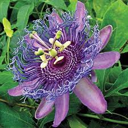

In [34]:
img = Image.open('/content/download2.jpg')
img.to_thumb(128,128)

In [35]:
model.predict('/content/download2.jpg')

('passion flower',
 tensor(66),
 tensor([1.3108e-06, 2.5611e-06, 7.4010e-06, 2.0166e-07, 3.5217e-08, 6.9835e-07, 4.7387e-06, 1.2952e-05, 1.6769e-05, 1.0165e-06, 1.0980e-07, 3.9292e-06, 1.4050e-06, 4.9399e-07, 2.5055e-06, 1.4042e-07,
         5.1517e-07, 1.4568e-06, 9.9068e-08, 5.6125e-08, 4.8248e-08, 4.0039e-06, 3.1068e-07, 5.1792e-07, 9.8105e-07, 5.0653e-07, 4.6114e-07, 1.4182e-07, 8.0242e-07, 7.0879e-07, 2.6893e-07, 6.7322e-06,
         7.0582e-07, 3.6017e-07, 8.5250e-07, 1.0218e-07, 3.3276e-06, 8.8927e-07, 2.9630e-07, 9.2349e-08, 6.8820e-06, 2.2166e-07, 8.4278e-07, 5.2809e-07, 3.9084e-07, 8.3765e-08, 1.8065e-05, 4.7262e-06,
         5.0111e-08, 4.1831e-07, 3.9787e-06, 6.1271e-05, 3.6903e-06, 9.2111e-07, 1.8104e-06, 1.8426e-07, 2.8743e-06, 5.0208e-07, 2.1415e-06, 2.4681e-07, 8.9346e-07, 2.4732e-06, 7.2373e-08, 3.1389e-07,
         9.2752e-07, 1.7607e-07, 9.9969e-01, 3.8263e-08, 1.0627e-07, 2.8001e-07, 1.4873e-06, 1.2921e-06, 8.8854e-07, 9.2533e-07, 2.5685e-07, 1.0845e-06, 5.7718e-08,

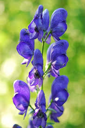

In [40]:
img = Image.open('/content/sample-5.jpg')
img.to_thumb(128,128)

In [41]:
model.predict('/content/sample-5.jpg')

('monkshood',
 tensor(60),
 tensor([1.0209e-07, 1.8217e-08, 1.3999e-08, 1.3966e-07, 4.4659e-07, 3.1922e-07, 4.2075e-07, 3.5557e-06, 5.5943e-08, 4.5179e-07, 8.1070e-07, 8.2717e-07, 9.6945e-09, 3.9983e-09, 7.4154e-08, 3.6300e-07,
         5.6374e-08, 2.1147e-07, 1.5985e-09, 5.6736e-07, 2.1813e-08, 2.2442e-05, 1.6139e-08, 1.2083e-07, 9.7972e-08, 1.1691e-07, 2.8861e-07, 3.9231e-06, 7.7961e-08, 3.4253e-08, 5.5676e-08, 1.4000e-07,
         1.7056e-06, 9.0709e-09, 1.2018e-07, 8.8950e-05, 6.1377e-08, 2.3568e-08, 1.5656e-05, 2.0371e-06, 4.7501e-08, 1.4371e-07, 6.1584e-08, 1.9855e-06, 1.3083e-07, 1.9775e-05, 3.7205e-08, 7.8600e-07,
         2.4483e-09, 9.8820e-09, 3.5455e-08, 3.7707e-08, 6.7530e-09, 3.2128e-07, 1.3782e-07, 2.3646e-07, 4.3193e-08, 3.6122e-07, 1.4774e-08, 5.4824e-06, 9.9954e-01, 6.5357e-07, 3.4921e-07, 2.9991e-07,
         1.5676e-08, 7.8524e-08, 1.4184e-09, 1.6536e-08, 1.0961e-07, 8.2441e-08, 5.4855e-06, 1.7654e-09, 6.5446e-08, 1.5747e-07, 1.3095e-07, 1.2643e-08, 7.3360e-08, 3.82